In [1]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go
import bloscpack as bp

from utils import*

In [9]:
points_c=get_file_ply("./data/suzanne.obj")
borders=get_borders(points_c)

min_x=borders[0].item()
max_x=borders[1].item()
min_y=borders[2].item()
max_y=borders[3].item()
min_z=borders[4].item()
max_z=borders[5].item()

In [10]:
def viz_quadtree_tmp(name="quadtree_viz.blp"):



    X, Y, Z = np.mgrid[min_x:max_x:64j, min_y:max_y:64j, min_z:max_z:64j]

    values = bp.unpack_ndarray_from_file(name)
    
    
    layout = go.Layout(
    autosize=False,
    width=1000,
    height=1000,
    xaxis=go.layout.XAxis(linecolor="black", linewidth=1, mirror=True),
    yaxis=go.layout.YAxis(linecolor="black", linewidth=1, mirror=True),
    margin=go.layout.Margin(l=50, r=50, b=100, t=100, pad=4),
    )
    
    fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=values.flatten(),
    isomin=5,
    isomax=15,
    opacity=0.3, # needs to be small to see through all surfaces
    surface_count=21, # needs to be a large number for good volume rendering
    ),layout=layout)
    
    fig.show()

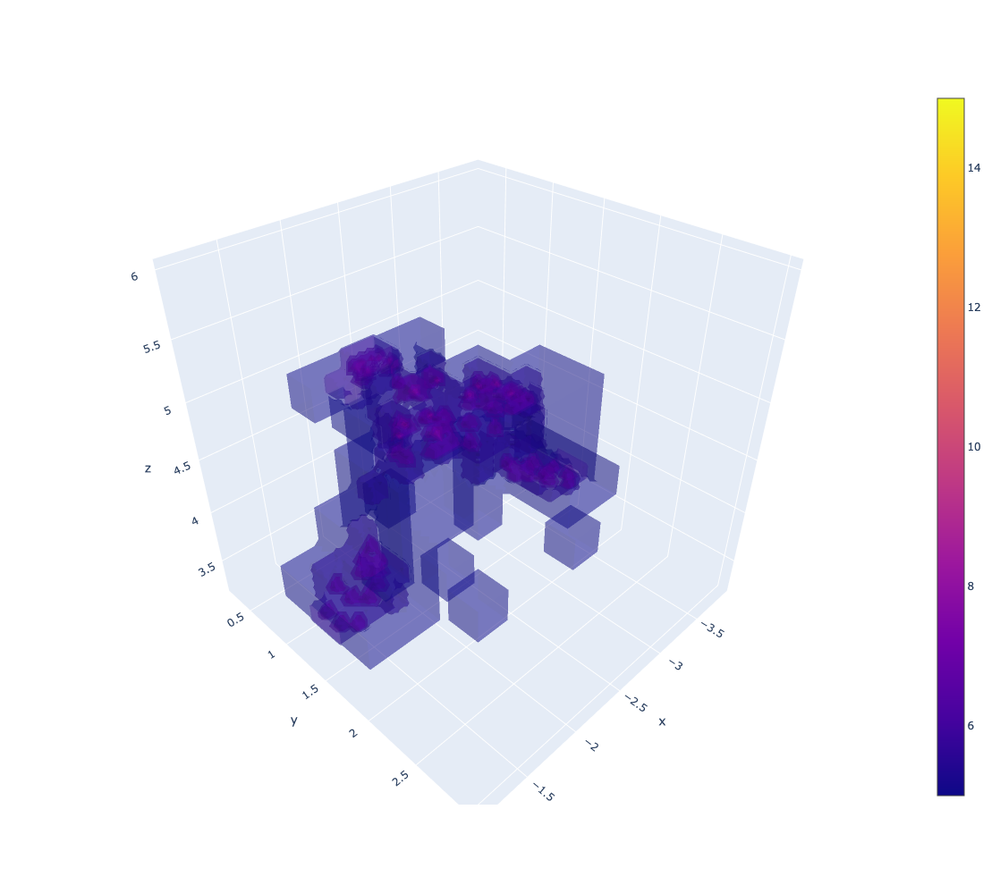

In [11]:
viz_quadtree_tmp(name="quadtree_viz.blp")